
# Assignment 3

This is a template notebook for Assignment 3.


## Install dependencies and initialization

In [ ]:
# The next 8 lines added to be compatible with version changes (2022/10/13).
# change cuda to 11.1
import os
p = os.getenv('PATH')
ld = os.getenv('LD_LIBRARY_PATH')
os.environ['PATH'] = f"/usr/local/cuda-11.1/bin:{p}"
os.environ['LD_LIBRARY_PATH'] = f"/usr/local/cuda-11.1/lib64:{ld}"
# change pytorch to 1.9.0 compiled with cuda 11.1
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html


# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html


In [ ]:
!pwd # shows current directory
!ls  # shows all files in this directory
!nvidia-smi # shows the specs and the current status of the allocated GPU

/content
'=2.0.1'   drive   output   sample_data
Wed Mar  1 06:44:47 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8    10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                       

In [ ]:
# import some common libraries
from google.colab.patches import cv2_imshow
from sklearn.metrics import jaccard_score
from PIL import Image, ImageDraw
from tqdm.notebook import tqdm
import pandas as pd
import numpy as np
import datetime
import random
import json
import cv2
import csv
import os

# import some common pytorch utilities
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torch.autograd import Variable
import torch.nn.functional as F
import torch.nn as nn
import torch

# import some common detectron2 utilities
import detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import Visualizer
from detectron2.data import build_detection_test_loader
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
setup_logger()

<Logger detectron2 (DEBUG)>

In [ ]:
# Make sure that GPU is available for your notebook. 
# Otherwise, you need to update the settungs in Runtime -> Change runtime type -> Hardware accelerator
torch.cuda.is_available()

True

In [ ]:
# You need to mount your google drive in order to load the data:
from google.colab import drive
drive.mount('/content/drive')
# Put all the corresponding data files in a data folder and put the data folder in a same directory with this notebook.
# Also create an output directory for your files such as the trained models and the output images.

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Define the location of current directory, which should contain data/train, data/test, and data/train.json.
# TODO: approx 1 line
BASE_DIR = '/content/drive/My Drive/SFU_CMPT_CV_lab3'
OUTPUT_DIR = '{}/output'.format(BASE_DIR)
os.makedirs(OUTPUT_DIR, exist_ok=True)

## Part 1: Object Detection

### Data Loader

In [ ]:
'''
# This function should return a list of data samples in which each sample is a dictionary. 
# Make sure to select the correct bbox_mode for the data
# For the test data, you only have access to the images, therefore, the annotations should be empty.
# Other values could be obtained from the image files.
# TODO: approx 35 lines
'''
def get_detection_data(set_name):
  #img = Image.open(data["file_name"])
  data_dirs = '{}/data'.format(BASE_DIR)
  train_dirs = '{}/data/train'.format(BASE_DIR)
  test_dirs = '{}/data/test'.format(BASE_DIR)
  json_file = os.path.join(data_dirs, "train.json")
  with open(json_file) as f:
    imgs_anns = json.load(f)

  dataset_dicts = []
  dataset = []
  objs = []
  Prev_file = ""
  
  if set_name == "test":             
      for filenames in os.listdir(test_dirs):
        
        if filenames.endswith(".png"):
          record = {}
          filename = os.path.join(test_dirs, filenames)
          img = Image.open(filename)
          width, height = img.size
          record["file_name"] = filename
          record["height"] = height
          record["width"] = width
          record["annotations"] =objs
          dataset.append(record) 

  else:
    for i in range(len(imgs_anns)):
            
      v = imgs_anns[i]
      filename = os.path.join(train_dirs, v["file_name"])
      record = {}
      
      if Prev_file != filename:
        dataset.append(record)
        objs = []
        Prev_file = filename

      img = Image.open(filename)

      width, height = img.size
        
      record["file_name"] = filename
      record["image_id"] = v["image_id"]
      record["height"] = height
      record["width"] = width

      obj = {
                "bbox": v["bbox"],
                "bbox_mode": BoxMode.XYWH_ABS,
                "segmentation": v["segmentation"],
                "category_id": 0,
                "category_name" : v["category_name"],
                "is_crowd" : v["iscrowd"],
        }
      objs.append(obj)
      record["annotations"] = objs

      if i == (len(imgs_anns) - 1):
        dataset.append(record)
      

  return dataset

In [ ]:
'''
# Remember to add your dataset to DatasetCatalog and MetadataCatalog
# Consdier "data_detection_train" and "data_detection_test" for registration
# You can also add an optional "data_detection_val" for your validation by spliting the training data
# TODO: approx 5 lines
'''
for d in ["train", "val","test"]:
  DatasetCatalog.register("plane_" + d, lambda d=d: get_detection_data(d))
  MetadataCatalog.get("plane_" + d).set(thing_classes=["plane"])
planes_metadata = MetadataCatalog.get("plane_train")



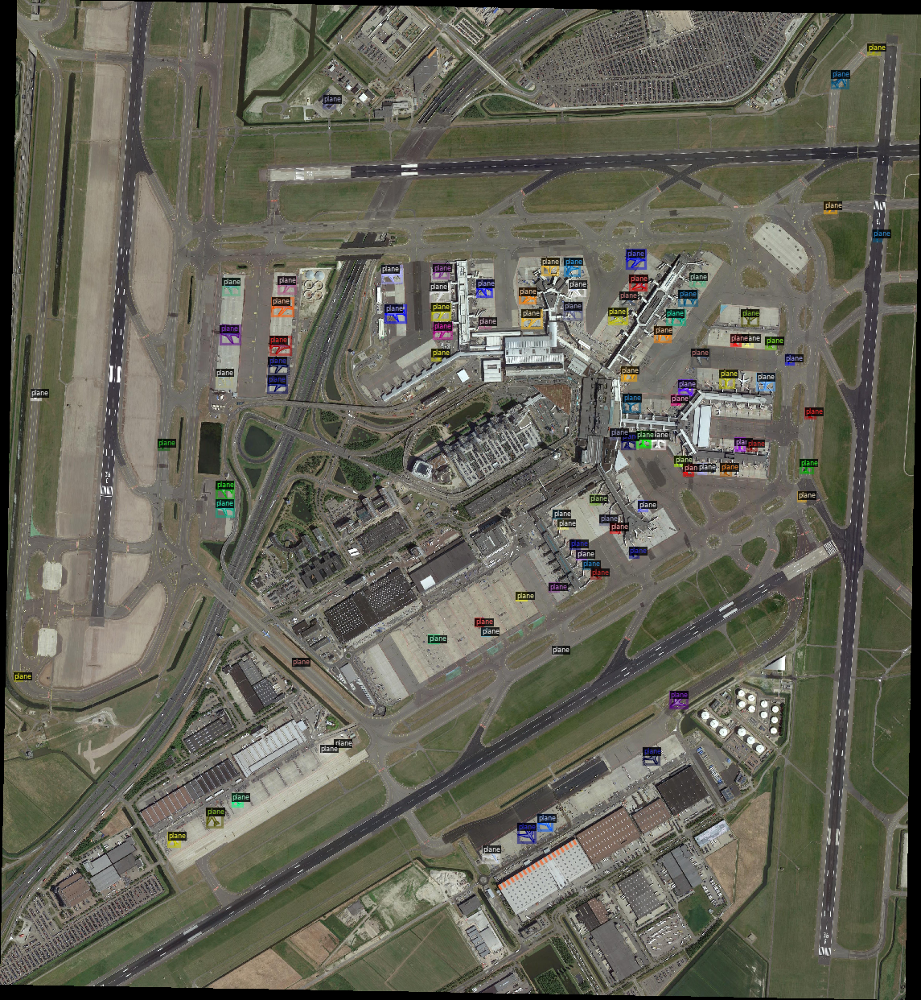

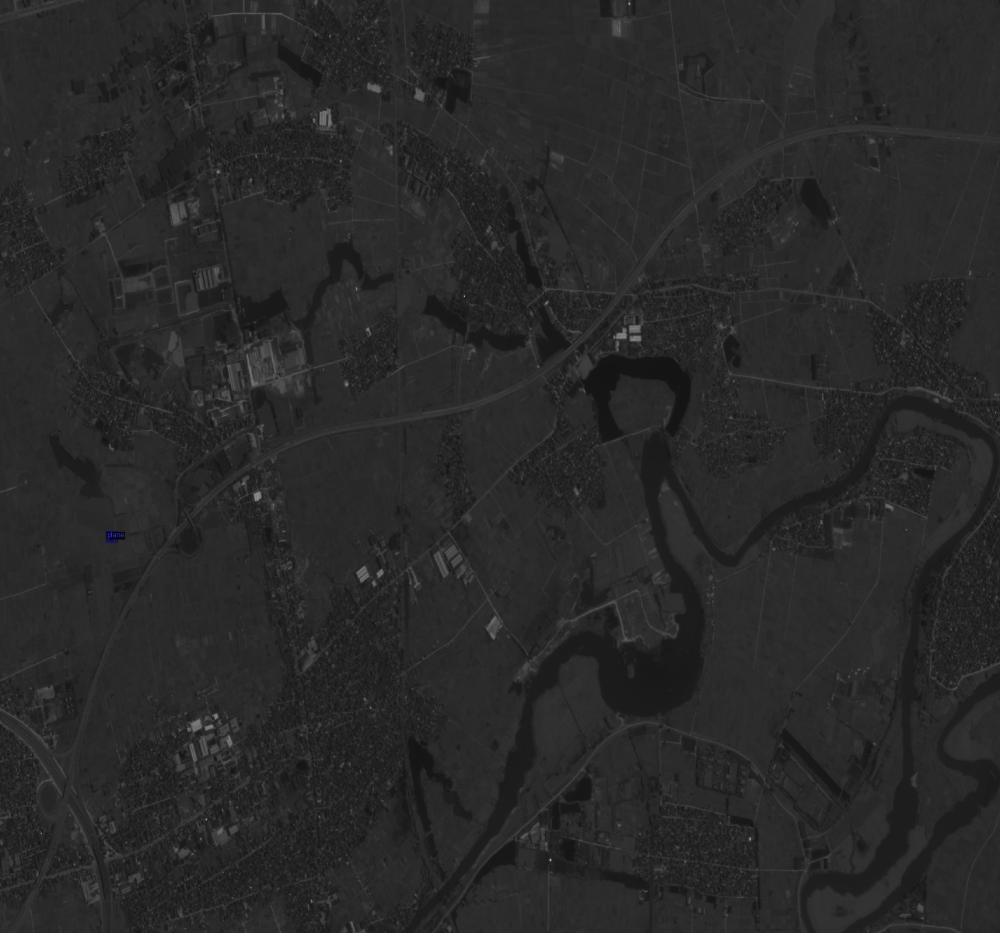

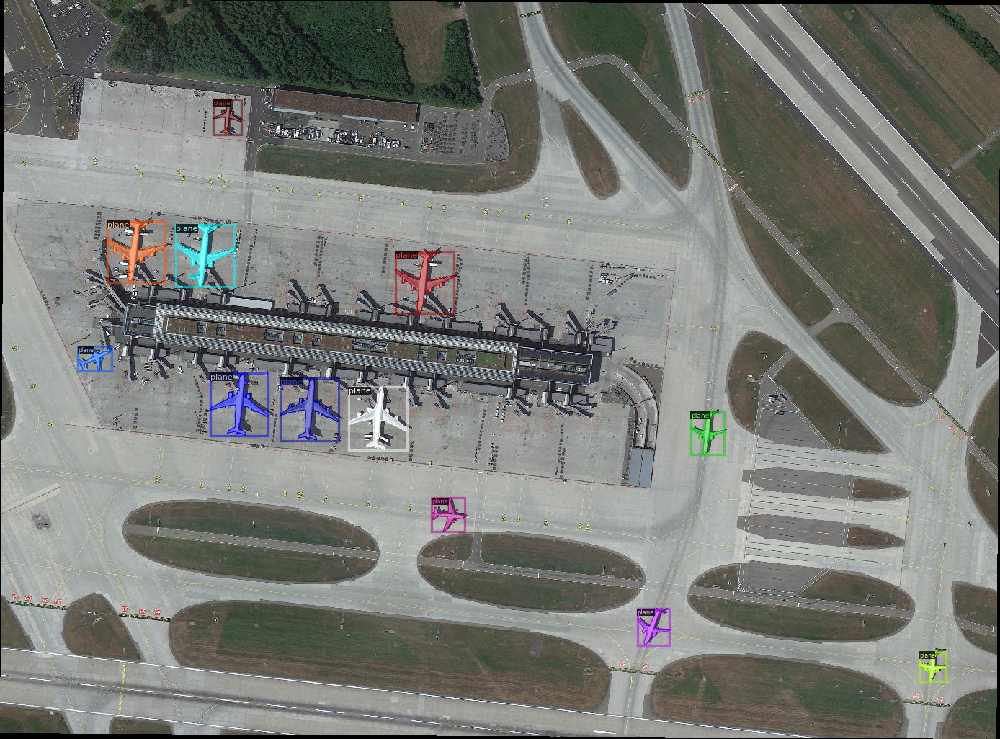

In [ ]:
'''
# Visualize some samples using Visualizer to make sure that the function works correctly
# TODO: approx 5 lines
'''
dataset_dicts = get_detection_data("train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=planes_metadata, scale=0.3)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])



### Set Configs

In [ ]:
'''
# Set the configs for the detection part in here.
# TODO: approx 15 lines
'''
cfg = get_cfg()
cfg.OUTPUT_DIR = "{}/output/".format(BASE_DIR)

cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
#cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("plane_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 1
#cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 500    
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)


### Training

In [ ]:
'''
# Create a DefaultTrainer using the above config and train the model
# TODO: approx 5 lines
'''
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[03/01 07:06:02 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

backbone.fpn_lateral2.{bias, weight}
backbone.fpn_lateral3.{bias, weight}
backbone.fpn_lateral4.{bias, weight}
backbone.fpn_lateral5.{bias, weight}
backbone.fpn_output2.{bias, weight}
backbone.fpn_output3.{bias, weight}
backbone.fpn_output4.{bias, weight}
backbone.fpn_output5.{bias, weight}
proposal_generator.rpn_head.anchor_deltas.{bias, weight}
proposal_generator.rpn_head.conv.{bias, weight}
proposal_generator.rpn_head.objectness_logits.{bias, weight}
roi_heads.box_head.fc1.{bias, weight}
roi_heads.box_head.fc2.{bias, weight}
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
  linear.{bias, weight}


[03/01 07:06:23 d2.engine.train_loop]: Starting training from iteration 0
[03/01 07:07:29 d2.utils.events]:  eta: 0:25:01  iter: 19  total_loss: 2.1  loss_cls: 0.6429  loss_box_reg: 0.04637  loss_rpn_cls: 0.6854  loss_rpn_loc: 0.7132  time: 3.3080  data_time: 0.9434  lr: 9.7405e-06  max_mem: 6693M
[03/01 07:08:29 d2.utils.events]:  eta: 0:21:59  iter: 39  total_loss: 1.886  loss_cls: 0.449  loss_box_reg: 0.06047  loss_rpn_cls: 0.6797  loss_rpn_loc: 0.6994  time: 3.1483  data_time: 0.6373  lr: 1.9731e-05  max_mem: 6693M
[03/01 07:09:26 d2.utils.events]:  eta: 0:20:00  iter: 59  total_loss: 1.943  loss_cls: 0.4033  loss_box_reg: 0.03983  loss_rpn_cls: 0.675  loss_rpn_loc: 0.6891  time: 3.0436  data_time: 0.4370  lr: 2.972e-05  max_mem: 6975M
[03/01 07:10:26 d2.utils.events]:  eta: 0:19:19  iter: 79  total_loss: 1.914  loss_cls: 0.4452  loss_box_reg: 0.06458  loss_rpn_cls: 0.6638  loss_rpn_loc: 0.5697  time: 3.0392  data_time: 0.6955  lr: 3.9711e-05  max_mem: 6975M
[03/01 07:11:21 d2.util

### Evaluation and Visualization

In [ ]:
%load_ext tensorboard
%tensorboard --logdir drive/My\ Drive/SFU_CMPT_CV_lab3/output

<IPython.core.display.Javascript object>

In [ ]:
'''
# After training the model, you need to update cfg.MODEL.WEIGHTS
# Define a DefaultPredictor
'''
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6
predictor = DefaultPredictor(cfg)

/usr/local/lib/python3.8/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


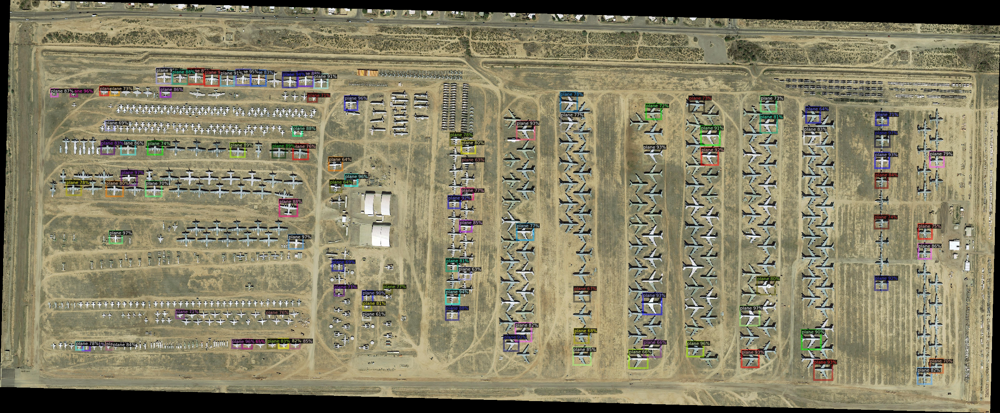

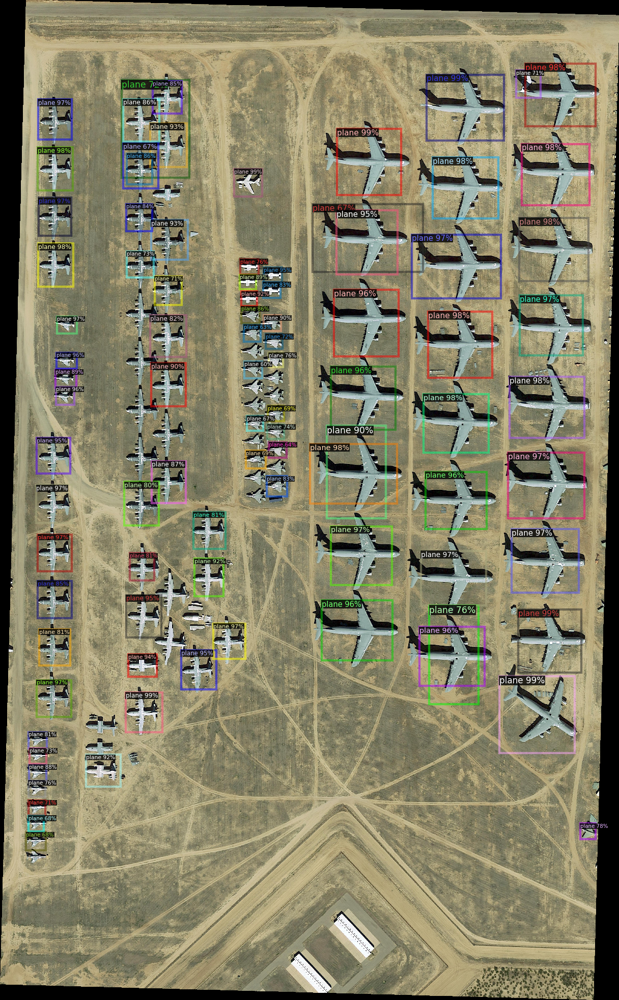

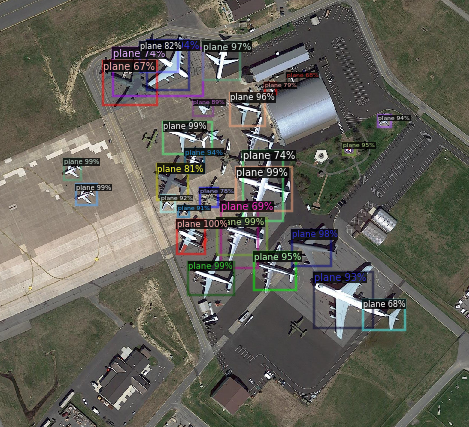

In [ ]:
'''
# Visualize the output for 3 random test samples
# TODO: approx 10 lines
'''
dataset_dicts = get_detection_data("test")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img) 

    visualizer = Visualizer(img[:, :, ::-1], metadata=planes_metadata, scale=0.3)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
'''
# Use COCOEvaluator and build_detection_train_loader
# You can save the output predictions using inference_on_dataset
# TODO: approx 5 lines
'''
evaluator = COCOEvaluator("plane_train", cfg, False, output_dir= "./output/")
val_loader = build_detection_test_loader(cfg, "plane_train")
print(inference_on_dataset(trainer.model, val_loader, evaluator))


WARNING [03/01 07:05:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/01 07:05:35 d2.evaluation.coco_evaluation]: Trying to convert 'plane_train' to COCO format ...
WARNING [03/01 07:05:35 d2.data.datasets.coco]: Using previously cached COCO format annotations at './output/plane_train_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[03/01 07:05:44 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   plane    | 7997         |
|            |              |
[03/01 07:05:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/01 07:05:44 d2.data.common]: Serializing 199 elements to byte tensors and concatenating them all ...
[03/01 07:05:44 d2.data.common]: Seri

NameError: ignored

### Improvements

For this part, you can bring any improvement which you have by adding new input parameters to the previous functions or defining new functions and variables.

In [ ]:
'''
# Bring any changes and updates regarding the improvement in here
'''


## Part 2: Semantic Segmentation

### Data Loader

In [ ]:

data_set = get_detection_data("train")

dicts = []

for v in data_set:
  filename = v['file_name']
  annotations =  v['annotations']
  height =  v['height']
  width = v['width']
  objects = []

  img = cv2.imread(filename)

  for anno in annotations:
    bbox = anno['bbox']
    segmentation = anno['segmentation']
    min_x = bbox[0]
    min_y = bbox[1]
    max_x = min_x+bbox[2]
    max_y = min_y+bbox[3]
    
    mask = detectron2.utils.visualizer.GenericMask(segmentation, height,width).mask

    obj_mask = mask[int(min_y):int(max_y), int(min_x):int(max_x)]
    obj_mask = cv2.resize(obj_mask, (128, 128), interpolation = cv2.INTER_AREA) 
    cropped = img[int(min_y):int(max_y), int(min_x):int(max_x)]
    obj_img = cv2.resize(cropped, (128, 128), interpolation = cv2.INTER_AREA) 

    obj = {
        "mask": obj_mask,
        "image" : obj_img,
        "bbox" : bbox,
    }
    objects.append(obj)

  inner_dict = {}
  inner_dict['filename'] = filename
  inner_dict['annotations'] = objects
  dicts.append(inner_dict)


In [ ]:
'''
# Write a function that returns the cropped image and corresponding mask regarding the target bounding box
# idx is the index of the target bbox in the data
# high-resolution image could be passed or could be load from data['file_name']
# You can use the mask attribute of detectron2.utils.visualizer.GenericMask 
#     to convert the segmentation annotations to binary masks
# TODO: approx 10 lines
'''

def get_instance_sample(data, idx, img=None):
  for total in range(len(dicts)):
    if dicts[total]['filename'] == data['file_name']:
      obj_mask = dicts [total] ['annotations'] [idx] ['mask']
      obj_img = dicts [total] ['annotations'] [idx] ['image']
      
      return obj_img, obj_mask




In [ ]:
'''
# We have provided a template data loader for your segmentation training
# You need to complete the __getitem__() function before running the code
# You may also need to add data augmentation or normalization in here
'''
          
class PlaneDataset(Dataset):
  def __init__(self, set_name, data_list):
      self.transforms = transforms.Compose([
          transforms.ToTensor(), # Converting the image to tensor and change the image format (Channels-Last => Channels-First)
      ])
      self.set_name = set_name
      self.data = data_list
      self.instance_map = []
      for i, d in enumerate(self.data):
        for j in range(len(d['annotations'])):
          self.instance_map.append([i,j])

  '''
  # you can change the value of length to a small number like 10 for debugging of your training procedure and overfeating
  # make sure to use the correct length for the final training
  '''
  def __len__(self):
      return len(self.instance_map)

  def numpy_to_tensor(self, img, mask):
    if self.transforms is not None:
        img = self.transforms(img)
    img = torch.tensor(img, dtype=torch.float)
    mask = torch.tensor(mask, dtype=torch.float)
    return img, mask

  '''
  # Complete this part by using get_instance_sample function
  # make sure to resize the img and mask to a fixed size (for example 128*128)
  # you can use "interpolate" function of pytorch or "numpy.resize"
  # TODO: 5 lines
  '''
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()
    idx = self.instance_map[idx]
    data = self.data[idx[0]]
    img, mask = get_instance_sample(data, idx[1])
    img, mask = self.numpy_to_tensor(img, mask)
    img = img.reshape((3,128,128))
    mask = mask.reshape((1,128,128))
    return img, mask

def get_plane_dataset(set_name='train', batch_size=2):
    my_data_list = DatasetCatalog.get("plane_{}".format(set_name))
    dataset = PlaneDataset(set_name, my_data_list)
    loader = DataLoader(dataset, batch_size=batch_size, num_workers=4,
                                              pin_memory=True, shuffle=True)
    return loader, dataset

### Network

In [ ]:
'''
# convolution module as a template layer consists of conv2d layer, batch normalization, and relu activation
'''
class conv(nn.Module):
    def __init__(self, in_ch, out_ch, activation=True):
        super(conv, self).__init__()
        if(activation):
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1),
             nn.BatchNorm2d(out_ch),
             nn.ReLU(inplace=True)
          )
        else:
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1)  
             )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# downsampling module equal to a conv module followed by a max-pool layer
'''
class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.layer = nn.Sequential(
            conv(in_ch, out_ch),
            nn.MaxPool2d(2)
            )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# upsampling module equal to a upsample function followed by a conv module
'''
class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=False):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

        self.conv = conv(in_ch, out_ch)

    def forward(self, x):
        y = self.up(x)
        y = self.conv(y)
        return y

'''
# the main model which you need to complete by using above modules.
# you can also modify the above modules in order to improve your results.
'''
class MyModel(nn.Module):
  
    def __init__(self):
        super(MyModel, self).__init__()
        
        self.input_conv = conv(3, 16)
        self.down1 = down(16, 32)
        self.down2 = down(32, 64)
        self.down3 = down(64, 128)
        self.down4 = down(128, 256)
        self.down5 = down(256, 512)


        self.up1 = up(512, 256)
        self.up2 = up(256, 128)
        self.up3 = up(128, 64)
        self.up4 = up(64, 32)
        self.up5 = up(32, 4)
        self.output_conv = conv(4, 1, False) # ReLu activation is removed to keep the logits for the loss function

    def forward(self, input):
      y = self.input_conv(input)
      y = self.down1(y)
      y = self.down2(y)
      y = self.down3(y)
      y = self.down4(y)
      y = self.down5(y)
      y = self.up1(y)
      y = self.up2(y)
      y = self.up3(y)
      y = self.up4(y)
      y = self.up5(y)
      output = self.output_conv(y)
      return output

### Training

In [ ]:
'''
# The following is a basic training procedure to train the network
# You need to update the code to get the best performance
# TODO: approx ? lines
'''

# Set the hyperparameters
num_epochs = 50
batch_size = 4
learning_rate = 0.01
weight_decay = 1e-5

model = MyModel() # initialize the model
model = model.cuda() # move the model to GPU
loader, _ = get_plane_dataset('train', batch_size) # initialize data_loader
crit = nn.BCEWithLogitsLoss() # Define the loss function
optim = torch.optim.SGD(model.parameters(), lr=learning_rate, weight_decay=weight_decay) # Initialize the optimizer as SGD

# start the training procedure
for epoch in range(num_epochs):
  total_loss = 0
  for (img, mask) in tqdm(loader):
    img = torch.tensor(img, device=torch.device('cuda'), requires_grad = True)
    mask = torch.tensor(mask, device=torch.device('cuda'), requires_grad = True)
    pred = model(img)
    loss = crit(pred, mask)
    optim.zero_grad()
    loss.backward()
    optim.step()
    total_loss += loss.cpu().data
  print("Epoch: {}, Loss: {}".format(epoch, total_loss/len(loader)))
  torch.save(model.state_dict(), '{}/output/{}_segmentation_model.pth'.format(BASE_DIR, epoch))

'''
# Saving the final model
'''
torch.save(model.state_dict(), '{}/output/final_segmentation_model.pth'.format(BASE_DIR))


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 0, Loss: 0.3436364233493805


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 1, Loss: 0.24535880982875824


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 2, Loss: 0.21644331514835358


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 3, Loss: 0.19929543137550354


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 4, Loss: 0.18696758151054382


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 5, Loss: 0.17757855355739594


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 6, Loss: 0.16937756538391113


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 7, Loss: 0.16274167597293854


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 8, Loss: 0.1565990298986435


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 9, Loss: 0.15070100128650665


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 10, Loss: 0.1457323580980301


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 11, Loss: 0.14118725061416626


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 12, Loss: 0.13633684813976288


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 13, Loss: 0.13262875378131866


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 14, Loss: 0.1292591392993927


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 15, Loss: 0.12640026211738586


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 16, Loss: 0.12227313220500946


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 17, Loss: 0.11864262819290161


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 18, Loss: 0.11550353467464447


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 19, Loss: 0.11294770985841751


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 20, Loss: 0.11023427546024323


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 21, Loss: 0.10757678002119064


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 22, Loss: 0.10564067214727402


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 23, Loss: 0.10352260619401932


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 24, Loss: 0.1017153412103653


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 25, Loss: 0.09952027350664139


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 26, Loss: 0.09720409661531448


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 27, Loss: 0.09534233063459396


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 28, Loss: 0.09348196536302567


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 29, Loss: 0.09288614243268967


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 30, Loss: 0.09033845365047455


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 31, Loss: 0.0888374075293541


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 32, Loss: 0.08724968135356903


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 33, Loss: 0.08622166514396667


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 34, Loss: 0.08509039878845215


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 35, Loss: 0.08365394920110703


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 36, Loss: 0.0826348289847374


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 37, Loss: 0.08122497797012329


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 38, Loss: 0.08022595942020416


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 39, Loss: 0.07920828461647034


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 40, Loss: 0.07798365503549576


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 41, Loss: 0.07756826281547546


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 42, Loss: 0.07608343660831451


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 43, Loss: 0.07509130984544754


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 44, Loss: 0.07387572526931763


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 45, Loss: 0.07351355999708176


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 46, Loss: 0.07268615067005157


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 47, Loss: 0.0720229297876358


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 48, Loss: 0.07090392708778381


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

Epoch: 49, Loss: 0.07068362087011337


### Evaluation and Visualization

/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:478: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


TypeError: ignored

In [ ]:
'''
# Before starting the evaluation, you need to set the model mode to eval
# You may load the trained model again, in case if you want to continue your code later
# TODO: approx 15 lines
'''
batch_size = 4
model = MyModel().cuda()
model.load_state_dict(torch.load('{}/output/final_segmentation_model.pth'.format(BASE_DIR)))
model = model.eval() # chaning the model to evaluation mode will fix the bachnorm layers
loader, dataset = get_plane_dataset('train', batch_size)

total_iou = 0
total_images = 0
for (img, mask) in tqdm(loader):
  with torch.no_grad():
    img = img.cuda()
    mask = mask.cpu().detach()
    mask = torch.unsqueeze(mask,1)
    pred = model(img).cpu().detach()

    '''
    ## Complete the code by obtaining the IoU for each img and print the final Mean IoU
    '''

    for i in range(img.shape[0]):

      masked = mask[i]
      ground_truth = nn.Sigmoid()(masked)[0]
      ground_truth = np.array(ground_truth)
      ground_truth = np.rint(ground_truth)

      pred_image = pred[i]
      pred_image = nn.Sigmoid()(pred_image)[0]
      pred_image = np.array(pred_image)
      pred_image = np.rint(pred_image)

      Probability = np.sum(np.logical_and (ground_truth, pred_image)) / np.sum(np.logical_or (ground_truth, pred_image))
      
      total_iou += Probability
      total_images+=1


overall_score = total_iou/total_images

print("IoU:",overall_score)


print("\n #images: {}, Mean IoU: {}".format(_, _))


  0%|          | 0/2000 [00:00<?, ?it/s]

<ipython-input-16-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-16-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-16-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-16-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

IoU: 0.8160094420176907

 #images: <__main__.PlaneDataset object at 0x7efdc79ca6a0>, Mean IoU: <__main__.PlaneDataset object at 0x7efdc79ca6a0>


<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, dtype=torch.float)
<ipython-input-27-8ff7c3079b41>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach()

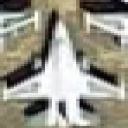

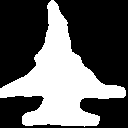

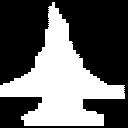

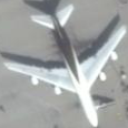

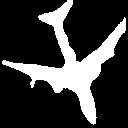

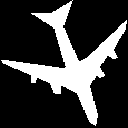

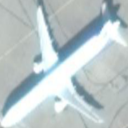

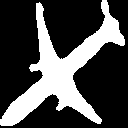

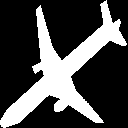

In [ ]:
'''
# Visualize 3 sample outputs
# TODO: approx 5 lines
'''
loader, dataset = get_plane_dataset('train', 3)

img, mask = next(iter(loader))
img = img.cuda()
mask = mask.cpu().detach()
pred = model(img).cpu().detach()
for i in range(3):
  image = img[i].cpu()
  im = transforms.ToPILImage()(image)
  cv2_imshow(np.array(im))
  prediction = np.rint(np.array(nn.Sigmoid()(pred[i])[0]))*255
  masked = np.array(mask[i])[0]*255
  cv2_imshow(prediction)
  cv2_imshow(masked)


## Part 3: Instance Segmentation

In this part, you need to obtain the instance segmentation results for the test data by using the trained segmentation model in the previous part and the detection model in Part 1.

### Get Prediction

In [ ]:
def sigmoid(x):
  return 1/(1 + np.exp(-x))

def get_prediction_mask(data, train = False):

  prediction_mask = np.zeros([data['height'], data['width']])
  ground_truth_mask = np.zeros([data['height'], data['width']])

  img = cv2.imread(data['file_name'])
  
  if train:
    imgs = []
    for i,j in enumerate(data['annotations']):
        bbox = j['bbox']
        x1, y1, x2, y2 = bbox
        to_be_masked = img[int(y1):int(y1+y2), int(x1):int(x1+x2)]
        try:
          to_be_masked = cv2.resize(to_be_masked, (128, 128), interpolation = cv2.INTER_AREA)
        except:
          print("error", int(x1),int(y1),int(x1+x2),int(y1+y2))
          continue
        prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0]
        prediction_from_mask = cv2.resize(prediction_from_mask[0], (int(x2), int(y2)), interpolation = cv2.INTER_AREA) 
        prediction_from_mask = np.rint(sigmoid(prediction_from_mask))*(i+1)
        # predicted_mask = prediction_mask[int(y1):int(y2), int(x1):int(x2)]
        # overlapping = np.maximum(predicted_mask,prediction_from_mask)
        # prediction_mask[int(y1):int(y2), int(x1):int(x2)] = overlapping 
        predicted_mask = prediction_mask[int(y1):int(y1+y2), int(x1):int(x1+x2)]
        predicted_mask[predicted_mask==0] = 10000
        overlapping = np.minimum(predicted_mask,prediction_from_mask)
        overlapping[overlapping == 1000] = 0
        prediction_mask[int(y1):int(y1+y2), int(x1):int(x1+x2)] = overlapping 
        
  else:
    prediction_for_img = predictor(img)['instances'] 
    imgs = []
    
    for i in range(len(prediction_for_img)):
        bbox = np.array(np.floor(list(prediction_for_img[i]._fields['pred_boxes'])[0].cpu().numpy()), dtype=np.uint32) 
        x1, y1, x2, y2 = bbox
        to_be_masked = img[int(y1):int(y2), int(x1):int(x2)]
        to_be_masked = cv2.resize(to_be_masked, (128, 128), interpolation = cv2.INTER_AREA)
        prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] 
        prediction_from_mask = cv2.resize(prediction_from_mask[0], (int(x2-x1), int(y2-y1)), interpolation = cv2.INTER_AREA) 
        prediction_from_mask = np.rint(sigmoid(prediction_from_mask))*(i+1)
        # predicted_mask = prediction_mask[int(y1):int(y2), int(x1):int(x2)]
        # overlapping = np.maximum(predicted_mask,prediction_from_mask)
        # prediction_mask[int(y1):int(y2), int(x1):int(x2)] = overlapping 
        predicted_mask = prediction_mask[int(y1):int(y2), int(x1):int(x2)]
        predicted_mask[predicted_mask==0] = 10000
        overlapping = np.minimum(predicted_mask,prediction_from_mask)
        overlapping[overlapping == 1000] = 0
        prediction_mask[int(y1):int(y2), int(x1):int(x2)] = overlapping 

  for i,j in enumerate(data['annotations']):
      bbox = j['bbox']
      x1, y1, x2, y2 = bbox
      x2 += x1
      y2 += y1
      local_true_mask = detectron2.utils.visualizer.GenericMask(j['segmentation'], data['height'], data['width']).mask
      overlapping = np.maximum(ground_truth_mask[int(y1):int(y2), int(x1):int(x2)],local_true_mask[int(y1):int(y2), int(x1):int(x2)]*(i+1))
      ground_truth_mask[int(y1):int(y2), int(x1):int(x2)] = overlapping


  return img, torch.tensor(ground_truth_mask, device=torch.device('cuda')), torch.tensor(prediction_mask, device=torch.device('cuda'))


### Visualization and Submission

In [ ]:
'''
# Visualise the output prediction as well as the GT Mask and Input image for a sample input
# TODO: approx 10 lines
'''
training_set = get_detection_data('train')
random = np.random.randint(0,60,3)
for i in random:

  img, gt_mask, pred_mask = get_prediction_mask(training_set[i])
  pred_mask = pred_mask.cpu().numpy()
  value_pred = pred_mask.max()
  value_pred = 255./value_pred
  pred_mask = pred_mask * value_pred

  gt_mask = gt_mask.cpu().numpy()
  value_gt = gt_mask.max()
  value_gt = 255./value_gt
  gt_mask = gt_mask * value_gt

  cv2_imshow(cv2.resize(img, (img.shape[1], img.shape[0]), interpolation = cv2.INTER_AREA))
  cv2_imshow(cv2.resize(gt_mask, (gt_mask.shape[1], gt_mask.shape[0]), interpolation = cv2.INTER_AREA))
  cv2_imshow(cv2.resize(pred_mask, (pred_mask.shape[1], pred_mask.shape[0]), interpolation = cv2.INTER_AREA))




<ipython-input-31-9e92b3fd5893>:43: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0]


In [ ]:
'''
# ref: https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# https://www.kaggle.com/c/airbus-ship-detection/overview/evaluation
'''
def rle_encoding(x):
    '''
    x: pytorch tensor on gpu, 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = torch.where(torch.flatten(x.long())==1)[0]
    if(len(dots)==0):
      return []
    inds = torch.where(dots[1:]!=dots[:-1]+1)[0]+1
    inds = torch.cat((torch.tensor([0], device=torch.device('cuda'), dtype=torch.long), inds))
    tmpdots = dots[inds]
    inds = torch.cat((inds, torch.tensor([len(dots)], device=torch.device('cuda'))))
    inds = inds[1:] - inds[:-1]
    runs = torch.cat((tmpdots, inds)).reshape((2,-1))
    runs = torch.flatten(torch.transpose(runs, 0, 1)).cpu().data.numpy()
    return ' '.join([str(i) for i in runs])

In [ ]:
'''
# You need to upload the csv file on kaggle
# The speed of your code in the previous parts highly affects the running time of this part
'''

preddic = {"ImageId": [], "EncodedPixels": []}

'''
# Writing the predictions of the training set
'''
my_data_list = DatasetCatalog.get("plane_{}".format('train'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample,True)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for index in inds:
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index)
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

'''
# Writing the predictions of the test set
'''

my_data_list = DatasetCatalog.get("plane_{}".format('test'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for j, index in enumerate(inds):
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index).double()
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

pred_file = open("{}/pred.csv".format(BASE_DIR), 'w')
pd.DataFrame(preddic).to_csv(pred_file, index=False)
pred_file.close()


  0%|          | 0/199 [00:00<?, ?it/s]

<ipython-input-40-ff2ba5b0dd8f>:22: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0]


ValueError: ignored

## Part 4: Mask R-CNN

For this part you need to follow a same procedure to part 2 with the configs of Mask R-CNN, other parts are generally the same as part 2.

### Data Loader

### Network

### Training

### Evaluation and Visualization